In [262]:
import torchvision
from torchvision import transforms
import torch
from torch import no_grad
import requests
import cv2
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

In [263]:
model_ = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)
model_.eval()

for name, param in model_.named_parameters():
    param.requires_grad = False

In [264]:
COCO_INSTANCE_CATEGORY_NAMES = [
    '__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'N/A', 'stop sign',
    'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow',
    'elephant', 'bear', 'zebra', 'giraffe', 'N/A', 'backpack', 'umbrella', 'N/A', 'N/A',
    'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball',
    'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket',
    'bottle', 'N/A', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl',
    'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza',
    'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'N/A', 'dining table',
    'N/A', 'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone',
    'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'N/A', 'book',
    'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush', 'gun'
]

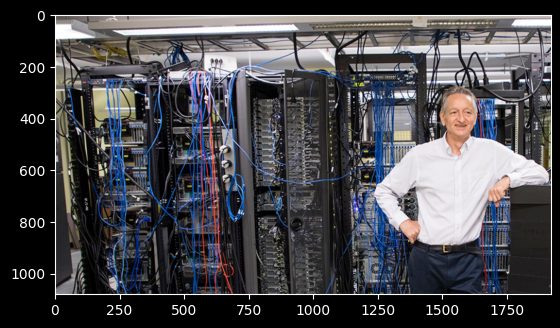

In [265]:
img_dir1 = 'jeff_hinton.png'
img = Image.open(img_dir1)
img.resize([int(0.5 * s) for s in img.size])
plt.imshow(img)
plt.show()

In [266]:
transform = transforms.Compose([transforms.ToTensor()])
img = transform(img)

In [267]:
pred = model_([img])

In [268]:
pred[0].keys()

dict_keys(['boxes', 'labels', 'scores'])

In [269]:
bounding_box = pred[0]['boxes'][0].tolist()
bounding_box

[1223.168701171875, 301.2500305175781, 1909.1724853515625, 1076.63720703125]

In [270]:
t, l, r, b = [round(x) for x in bounding_box]
print(t, l, r, b)

1223 301 1909 1077


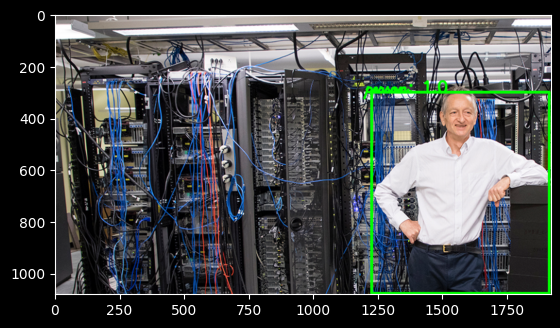

In [271]:
img_plot = (np.clip(cv2.cvtColor(np.clip(img.numpy().transpose((1, 2, 0)),0,1), cv2.COLOR_RGB2BGR),0,1)*255).astype(np.uint8)
label = pred[0]["labels"][0].item()
p = pred[0]["scores"][0].item()
cv2.rectangle(img_plot, (t, l), (r, b), (0, 255, 0), 10)
cv2.putText(img_plot, COCO_INSTANCE_CATEGORY_NAMES[label] + ": "+ str(round(p, 2)), (t-20, l), cv2.FONT_HERSHEY_SCRIPT_SIMPLEX, 2, (0, 255, 0), 8)
plt.imshow(cv2.cvtColor(img_plot, cv2.COLOR_BGR2RGB))
plt.show()

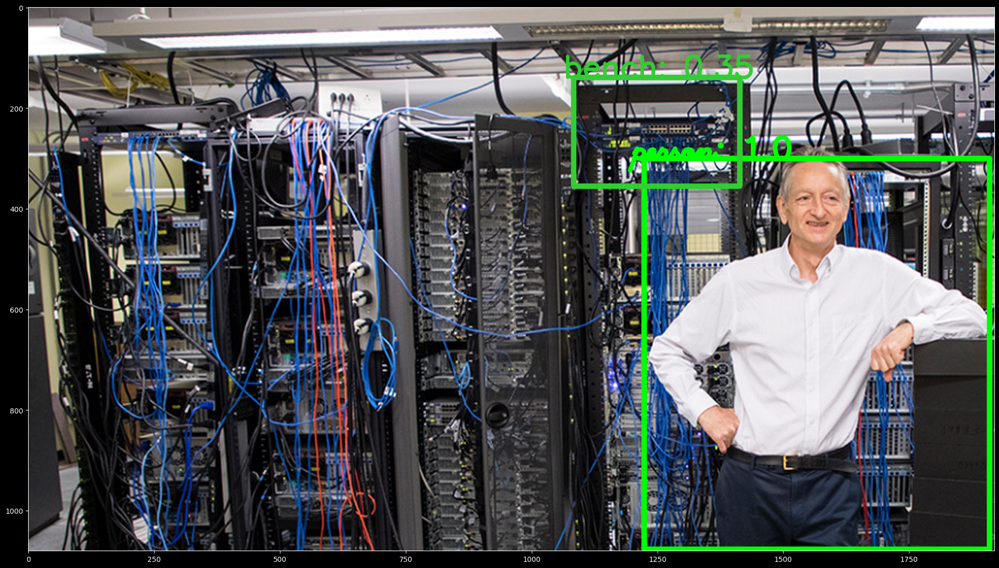

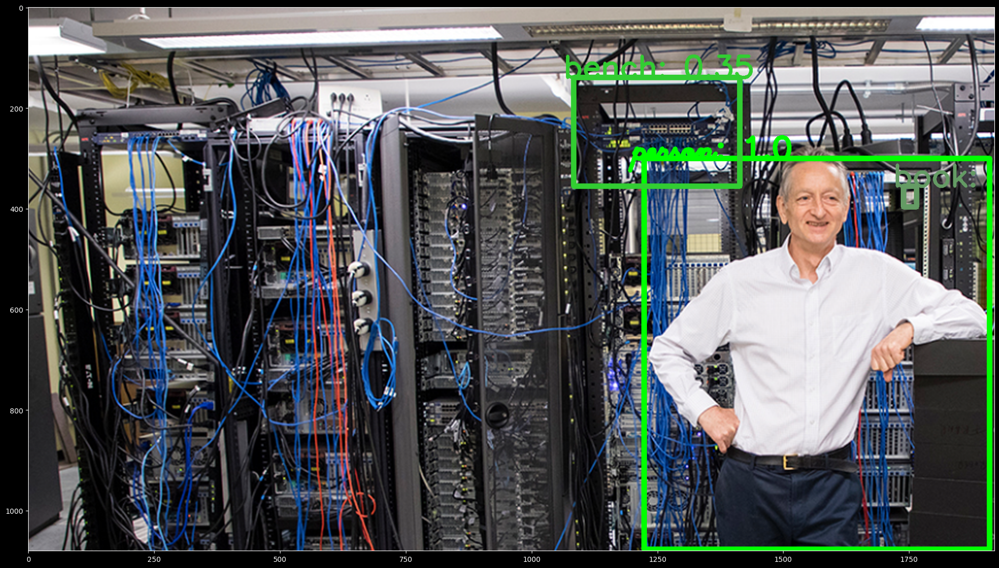

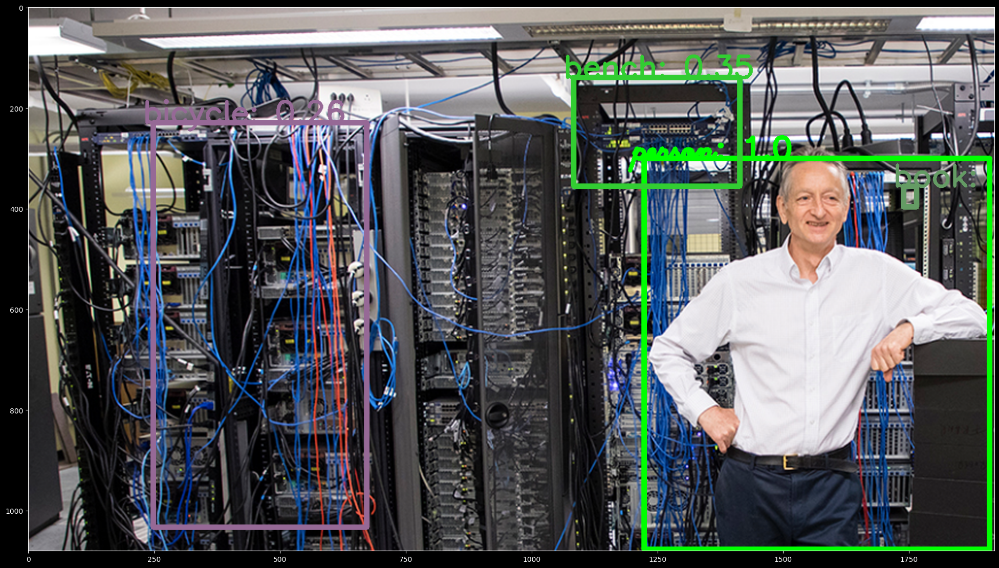

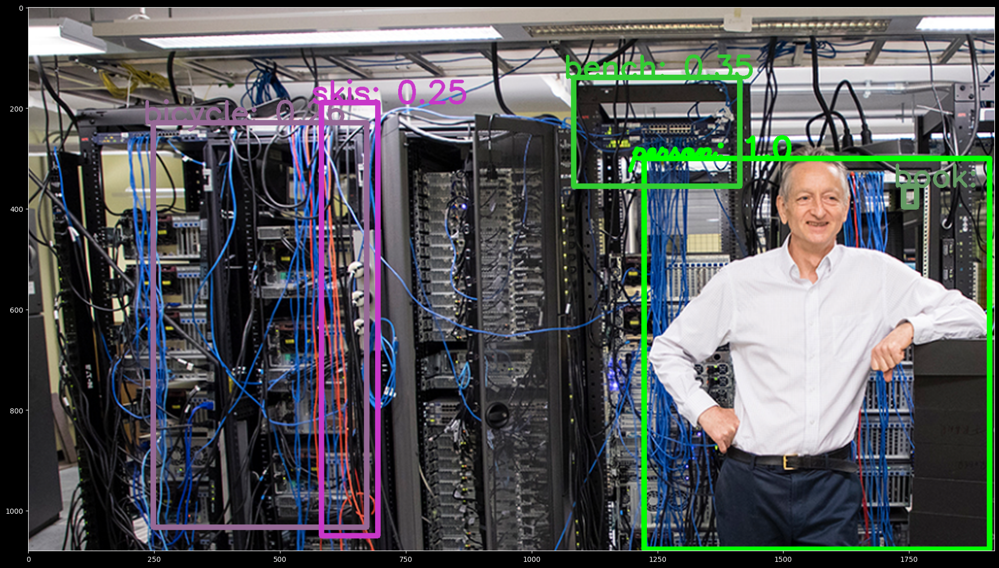

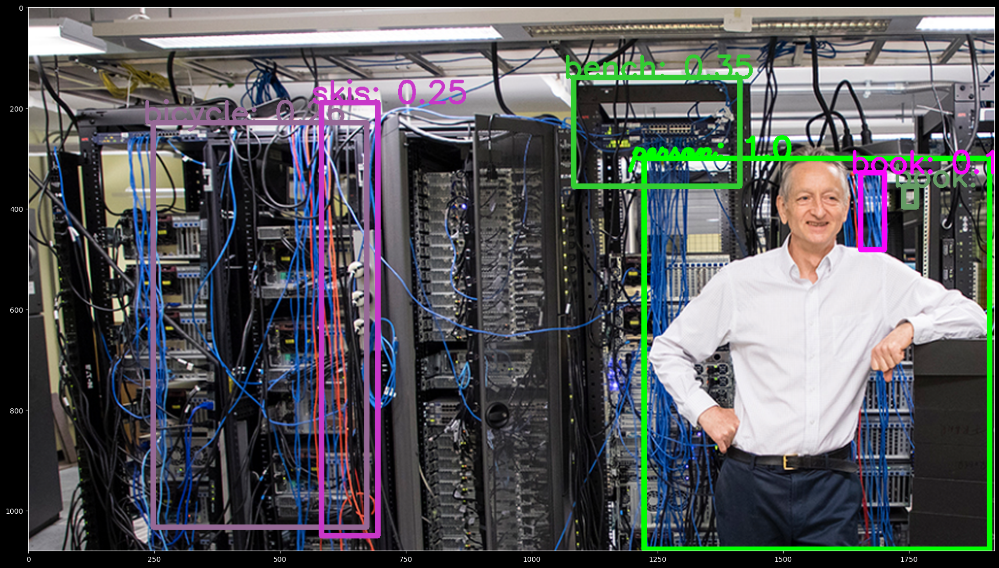

In [272]:
for i in range(1, 6):
    bound = pred[0]['boxes'][i].tolist()
    t, l, r, b = [round(x) for x in bound]
    label = pred[0]["labels"][i].item()
    p = pred[0]["scores"][i].item()
    cv2.rectangle(img_plot, (t, l), (r, b), (50*i, 255-50*i, 50*i), 10)
    cv2.putText(img_plot, COCO_INSTANCE_CATEGORY_NAMES[label] + ": " + str(round(p, 2)), (t - 20, l), cv2.FONT_HERSHEY_SIMPLEX, 2, (i*50, 255-i*50, i*50), 5)
    plt.figure(figsize=(80, 80))
    plt.subplot(5, 1, i)
    plt.imshow(cv2.cvtColor(img_plot, cv2.COLOR_BGR2RGB))
    plt.show()
    

In [273]:
def RCNN(imgdir, model, numpred = 1):
    img = Image.open(imgdir)
    transform = transforms.Compose([transforms.ToTensor()])
    img = transform(img)
    pred = model([img])
    img_plot = (np.clip(cv2.cvtColor(np.clip(img.numpy().transpose((1, 2, 0)), 0, 1), cv2.COLOR_RGB2BGR), 0, 1)*255).astype(np.uint8)
    if numpred > len(pred[0]["labels"]):
        numpred = len(pred[0]["labels"])
    for i in range(numpred):
        label = pred[0]["labels"][i].item()
        p = pred[0]["scores"][i].item()
        bound = pred[0]["boxes"][i].tolist()
        t, l, r, b = [round(x) for x in bound]
        color = ((255 - 18*i) % 255, (125 - 18*i) % 255, 28*i%255)
        cv2.rectangle(img_plot, (t, l), (r, b), color, 1)
        cv2.putText(img_plot, COCO_INSTANCE_CATEGORY_NAMES[label] + ": " + str(round(p, 2)), (t - 30, l), cv2.FONT_HERSHEY_SIMPLEX, 0.8, color, 1)
        plt.figure(figsize=(60, 60))
        plt.subplot(numpred, 1, i+1)
        plt.imshow(cv2.cvtColor(img_plot, cv2.COLOR_BGR2RGB))
        plt.show()
    

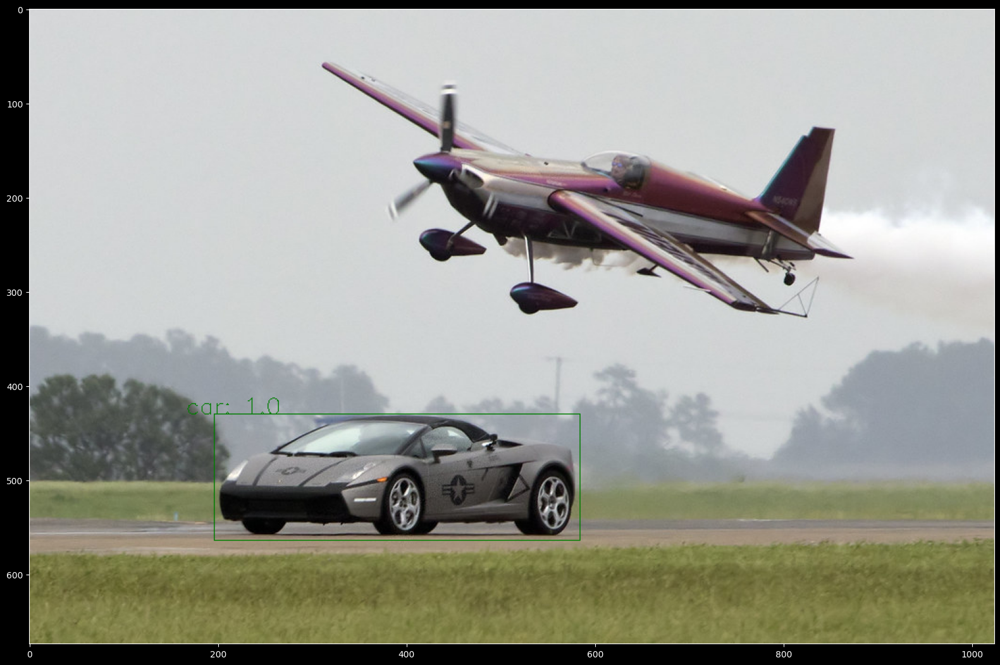

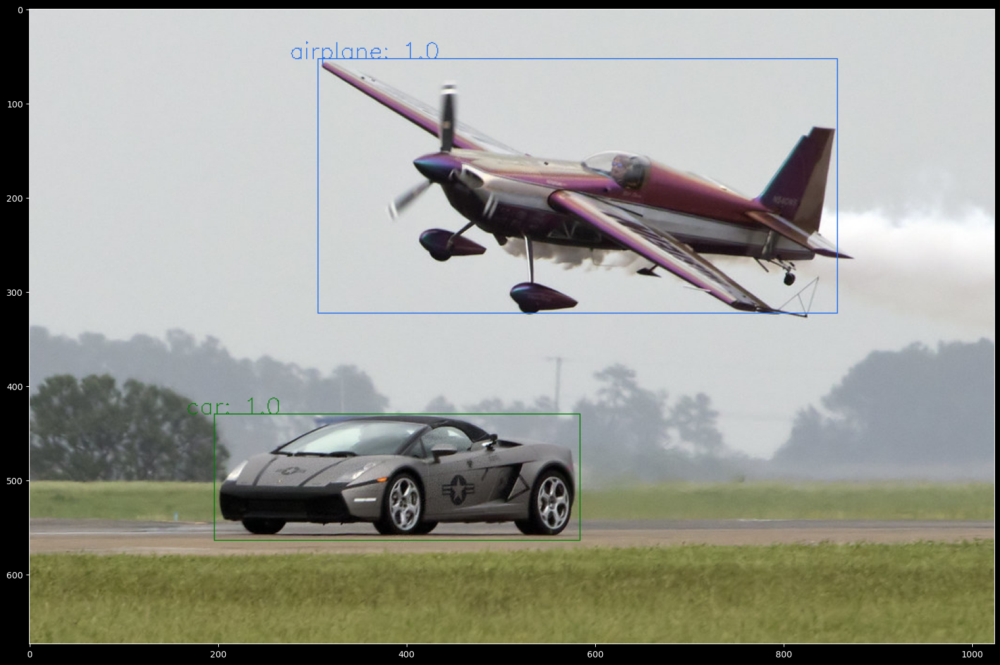

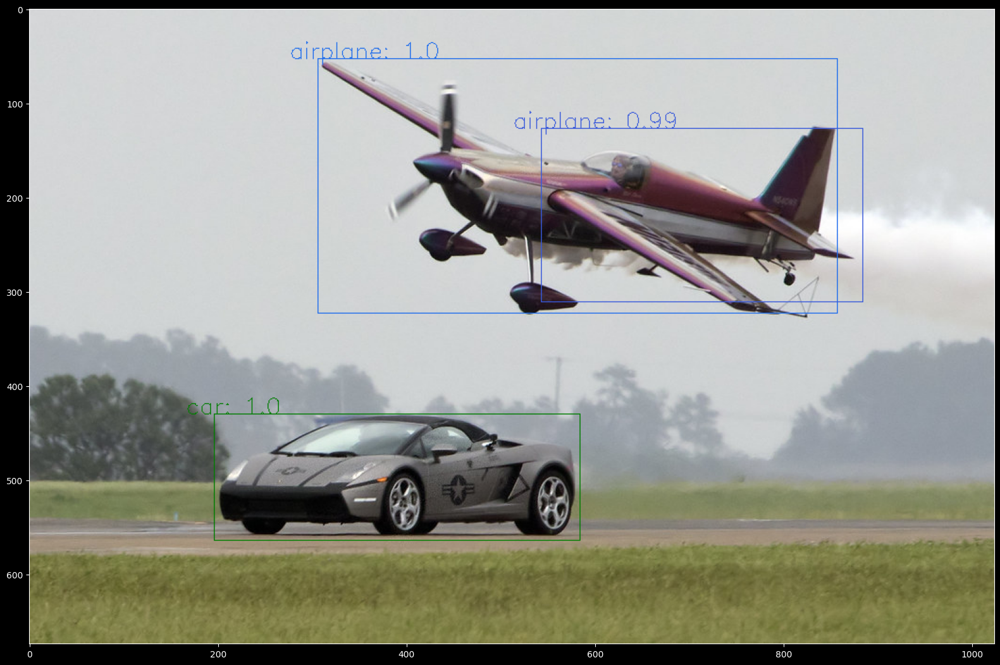

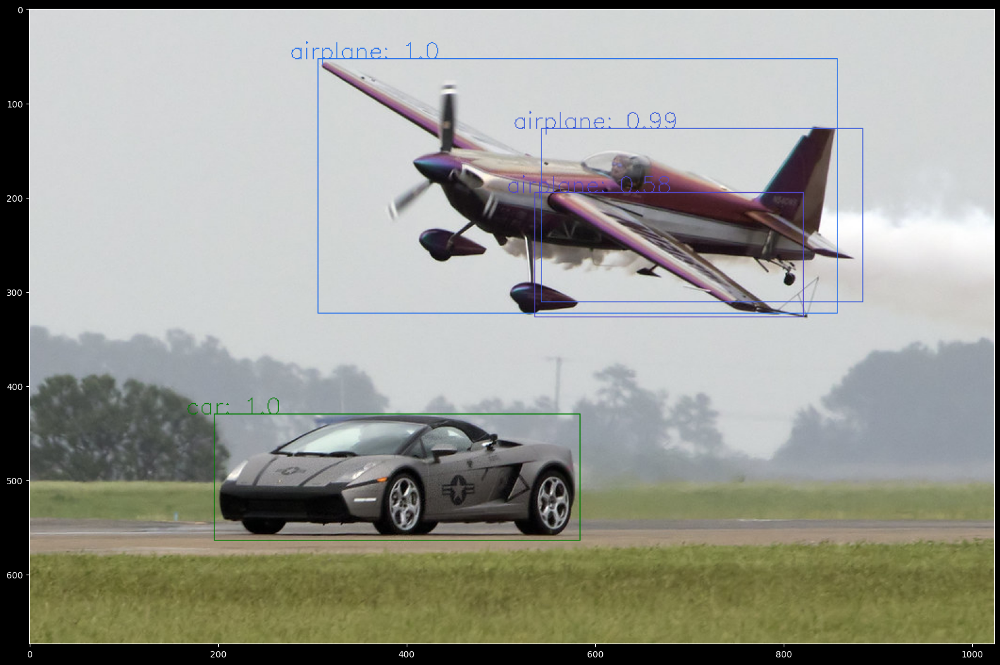

In [274]:
imgdir = "watts_photos2758112663727581126637_b5d4d192d4_b.jpeg"
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained = True)
model.eval()

for name, param in model.named_parameters():
    param.requires_grad = False
RCNN(imgdir, model, 6)

In [275]:
model.parameters()

<generator object Module.parameters at 0x000002CE076844A0>

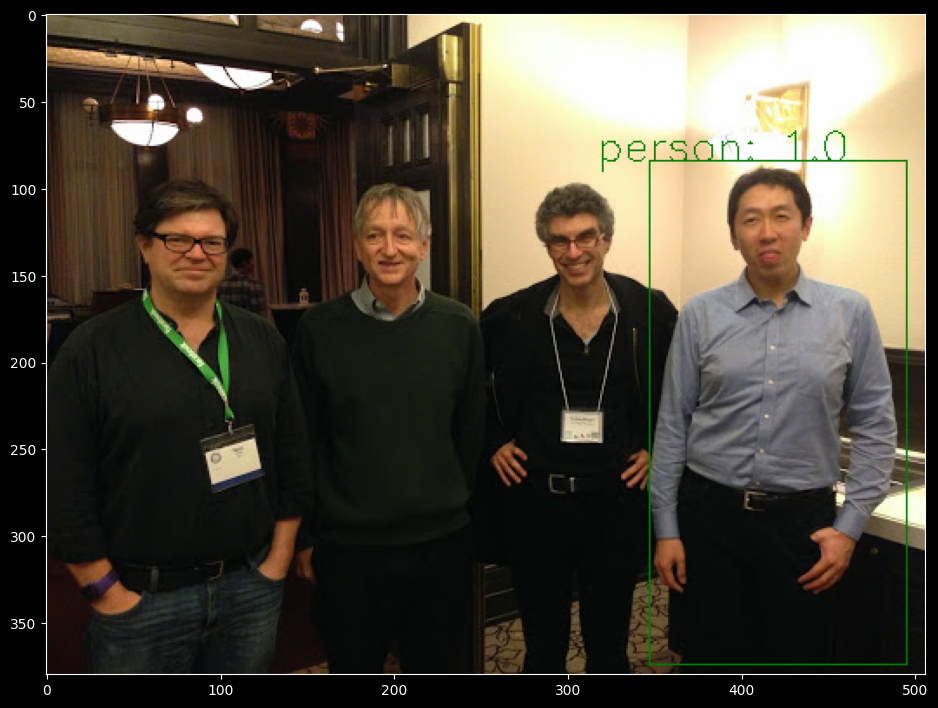

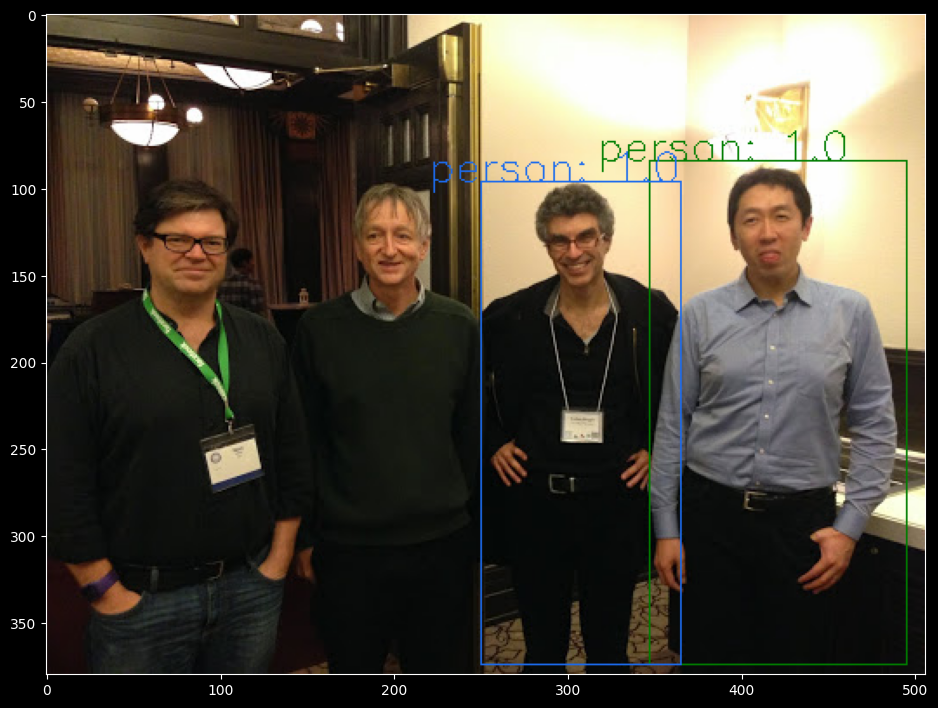

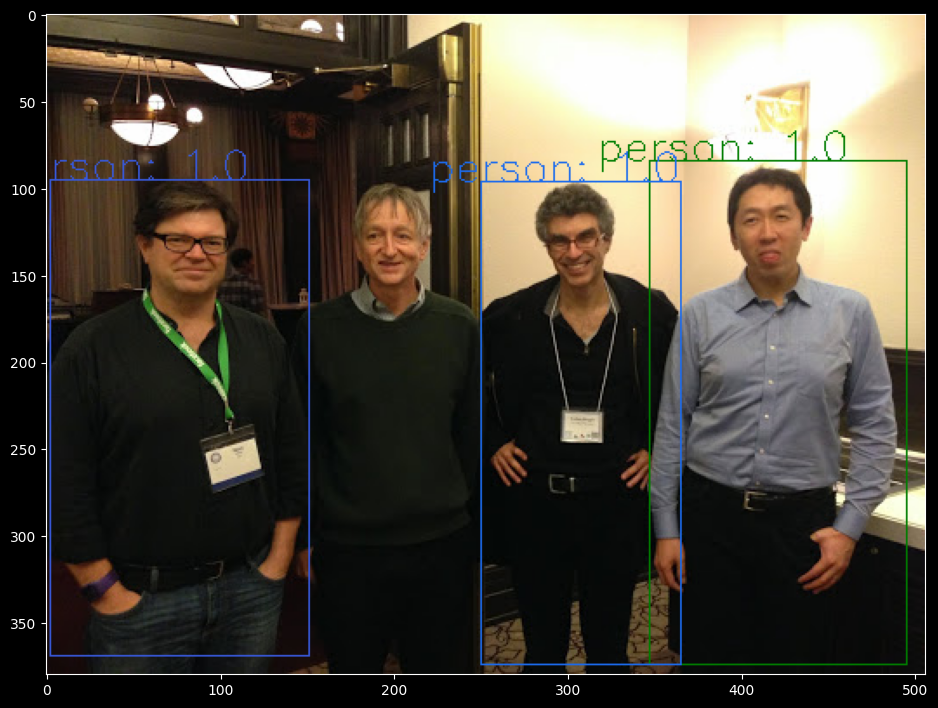

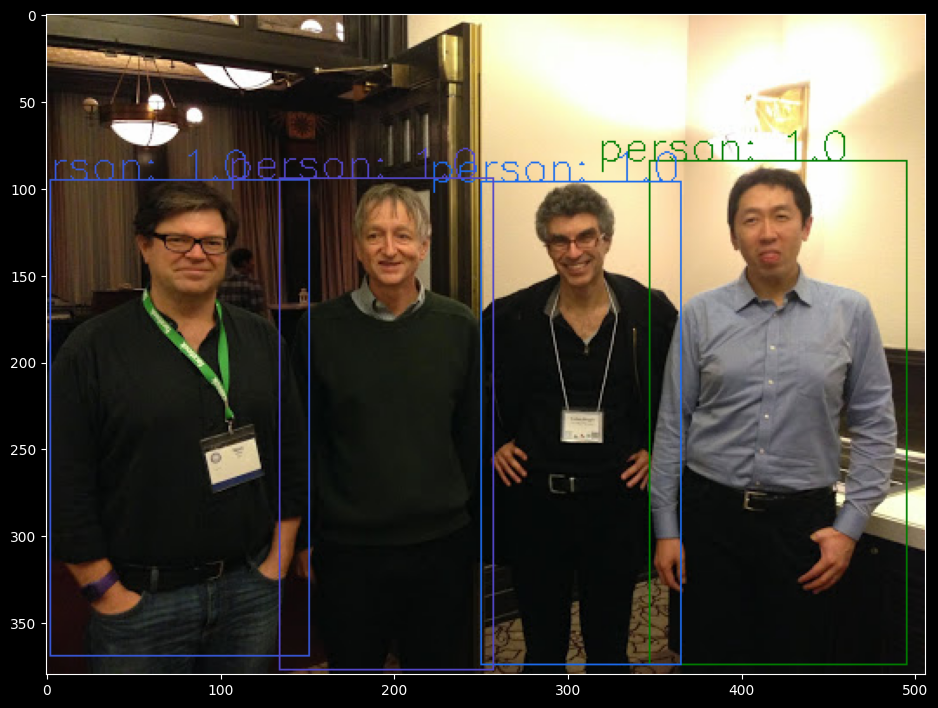

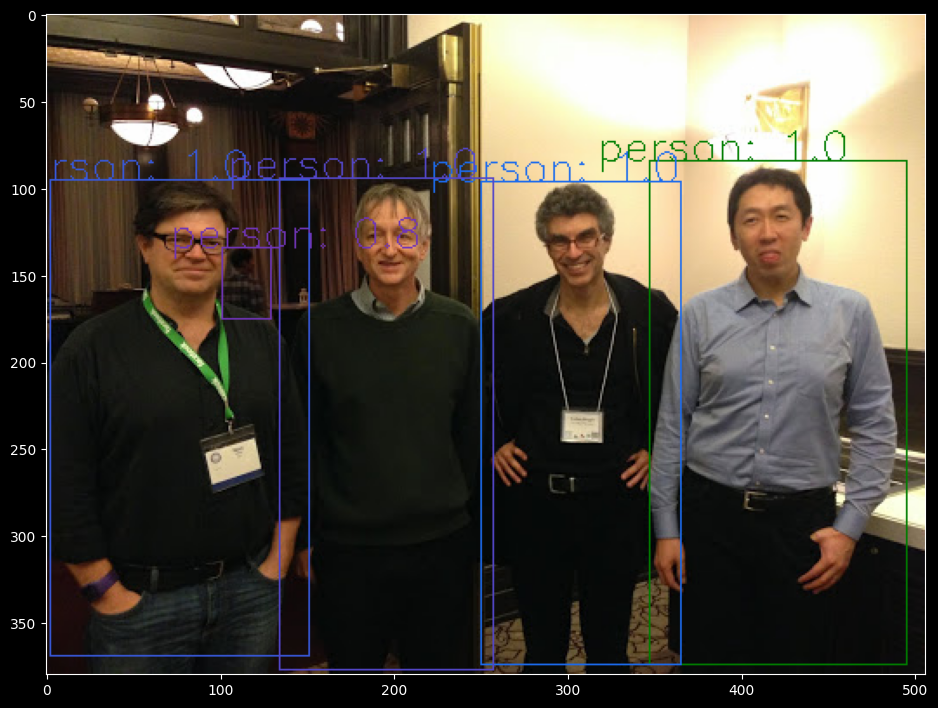

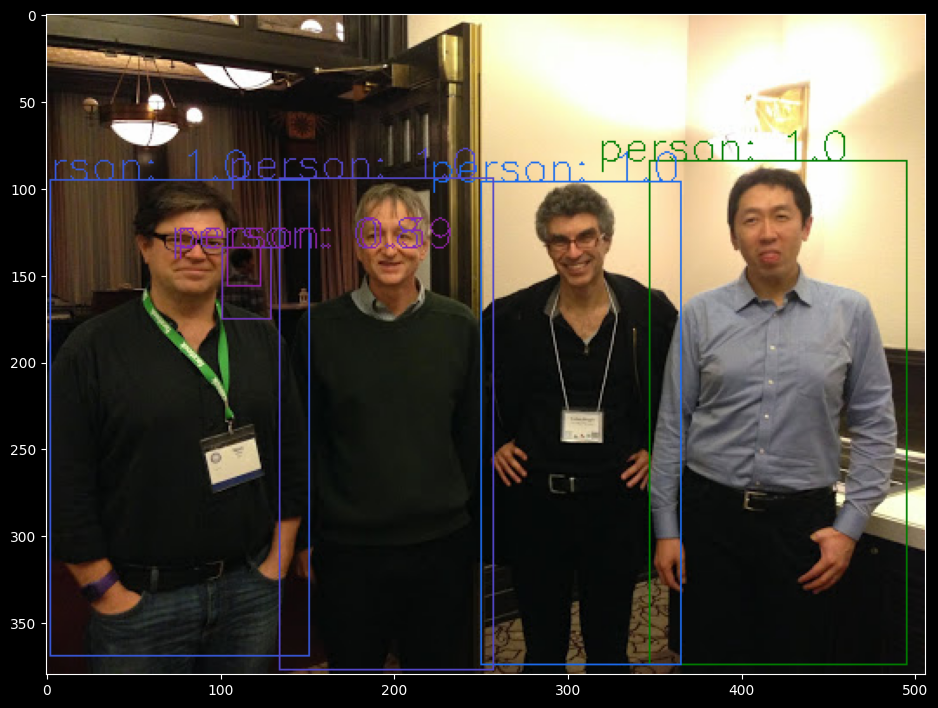

In [276]:
imgdir2 = "DLguys.jpeg"
RCNN(imgdir2, model, 6)

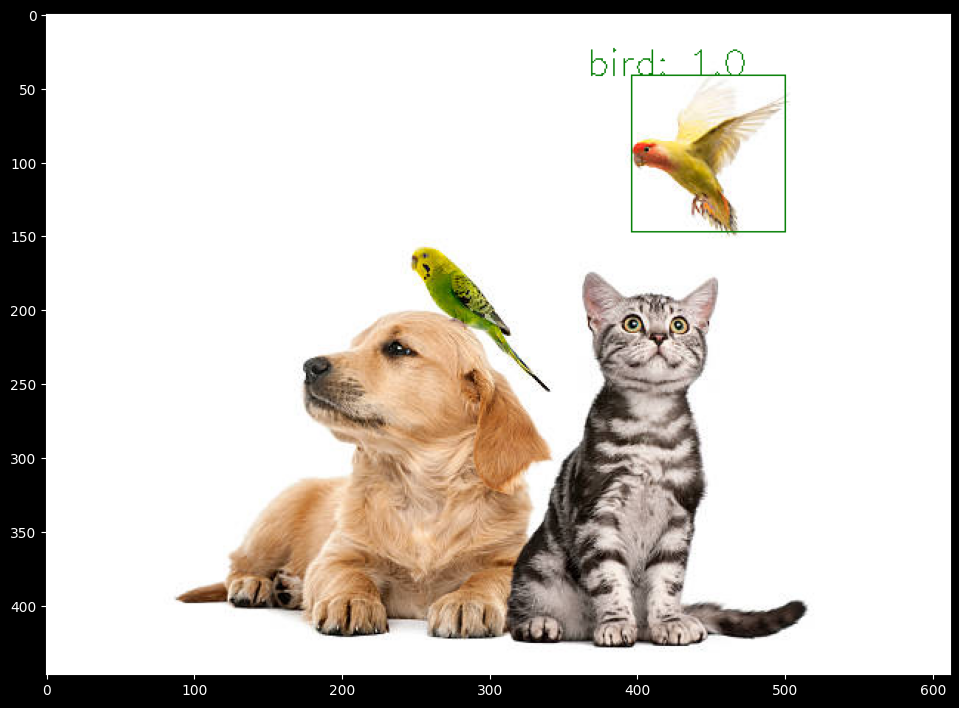

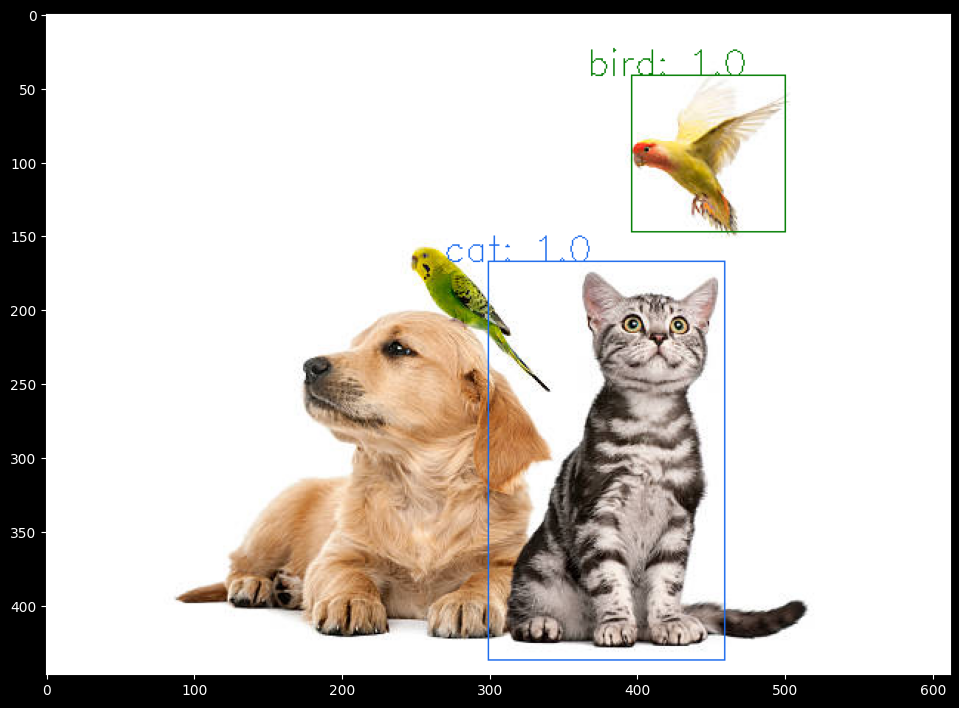

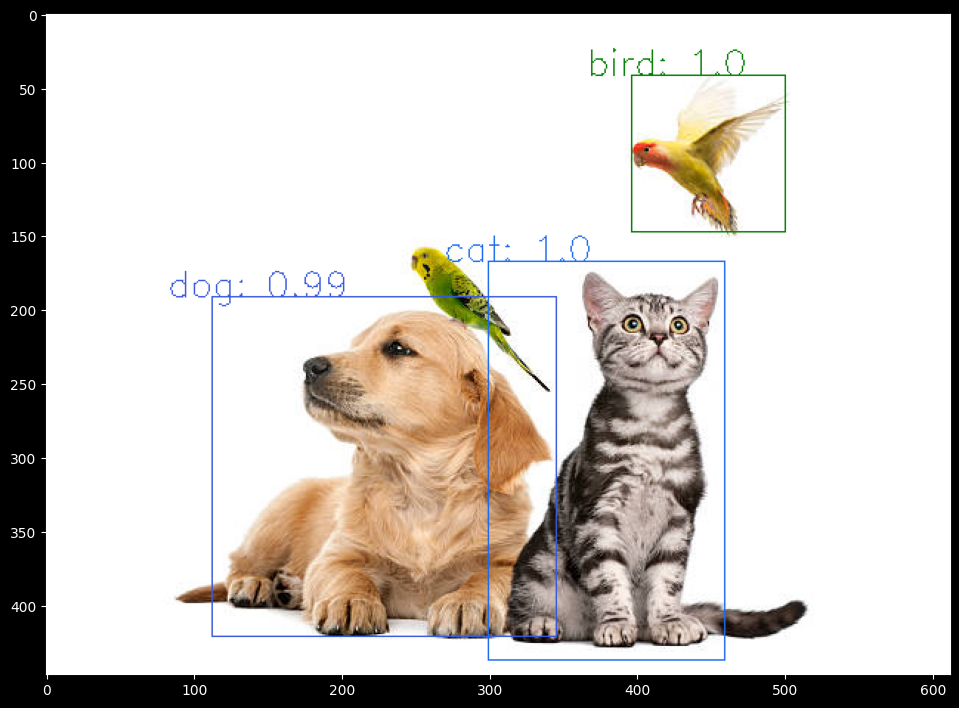

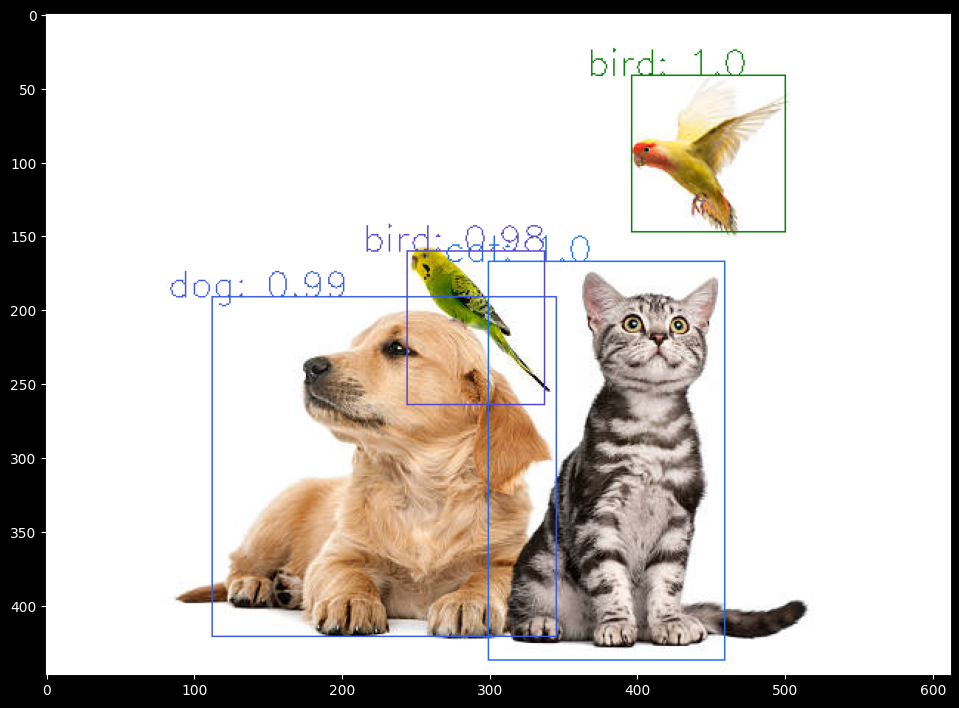

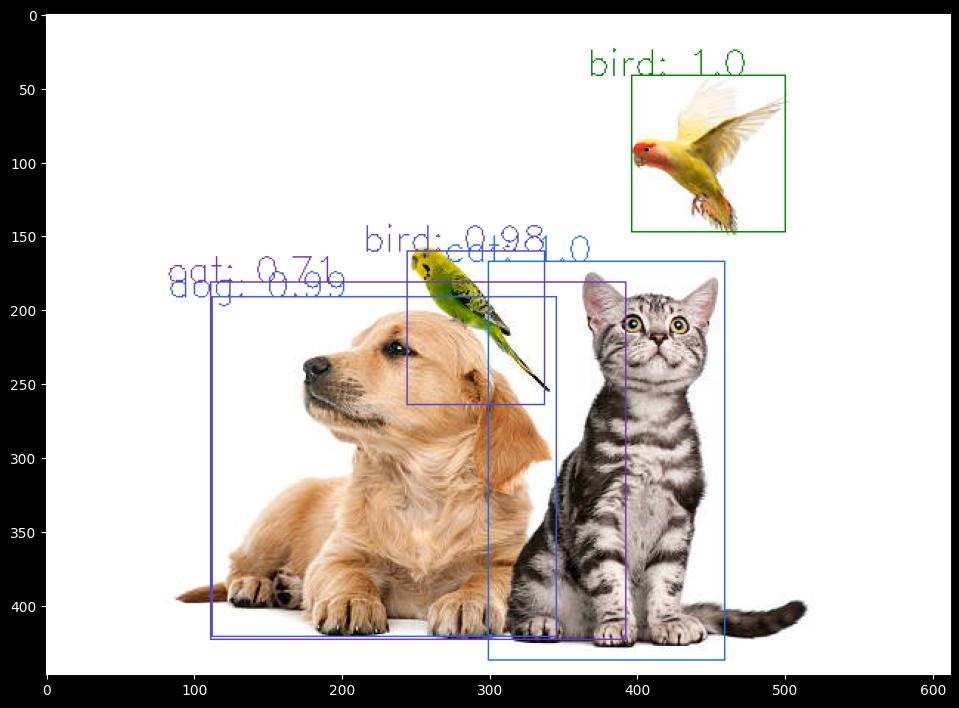

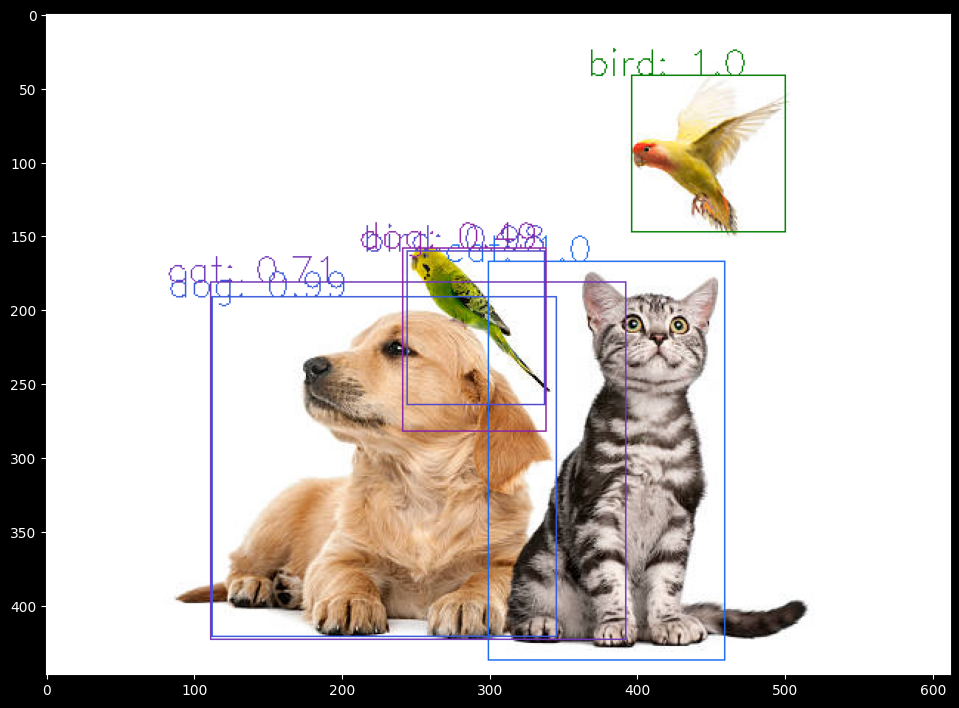

In [277]:
imgdir3 = "istockphoto-187786732-612x612.jpeg"
RCNN(imgdir3, model, 6)